In [2]:
import os
import re
import sys

import numpy as np
import numpy as np
import pandas as pd
import seaborn as sns
from sklearn import metrics as skmetrics
from scipy import stats
import matplotlib.pyplot as plt
from matplotlib import gridspec
from matplotlib.font_manager import fontManager
from IPython.display import display
from ipywidgets import interact, FloatSlider
from umap import UMAP
import ipynbname
from endaaman.ml import fix_global_seed

fix_global_seed()

project_root = os.path.abspath(os.path.join(os.path.dirname(ipynbname.path()), '..'))
if project_root not in sys.path:
    sys.path.insert(0, project_root)
os.chdir(project_root)
print('now working', project_root)


sns.set_theme(style='ticks', palette='tab10')
plt.rcParams.update({
    'font.size': 14,
    'axes.titlesize': 18,
    'axes.labelsize': 16,
    'xtick.labelsize': 14,
    'ytick.labelsize': 14,
    'legend.fontsize': 16,
    'figure.dpi': 300,
})

os.makedirs('out/figs', exist_ok=True)

now working /home/ken/src/github.com/endaaman/bt


In [4]:
dfs = []
for fold in range(5):
    df = pd.read_excel(f'out/compare/LMGAOB/fold5_{fold}/unfrozen_uni_500/test/report.xlsx', sheet_name='cases', index_col=0)
    # df = pd.read_excel(f'out/compare/LMGAOB/fold5_{fold}/unfrozen_baseline-vit_500/test/report.xlsx', sheet_name='cases', index_col=0)
    df['fold'] = fold
    dfs.append(df)
df = pd.concat(dfs)

df = df[df['diag_org'] != 'B']

f = df[df['correct3'] < 1]
print(len(df))
print(len(f))
f

249
4


,diag_org,gt,pred(vote),pred(sum),correct,acc,correct3,correct4,L,M,G,A,O,B,fold
name,,,,,,,,,,,,,,,
21-2158,M,M,L,L,0,0.423529,0,0,0.544000,0.421595,0.031743,0.002360,0.000213,0.000090,1
N22-263,L,L,A,A,0,0.169154,0,0,0.157159,0.000850,0.031770,0.548288,0.142654,0.119279,3
N21-327,G,G,L,L,0,0.407407,0,0,0.580115,0.000044,0.418760,0.000932,0.000090,0.000058,4
N20-216,M,M,G,G,0,0.126960,0,0,0.034366,0.140180,0.825246,0.000074,0.000056,0.000077,4


In [42]:
np.array(list('LMGAOB'))[np.array([4, 2, 5, 1, 9, 100]).argsort()[::-1]]

array(['B', 'O', 'G', 'L', 'M', 'A'], dtype='<U1')

In [46]:
dfs = []
for fold in range(5):
    df = pd.read_excel(f'out/compare/LMGAOB/fold5_{fold}/frozen_gigapath_500/ebrains.xlsx', sheet_name='cases', index_col=0)
    df['fold'] = fold
    dfs.append(df)
df = pd.concat(dfs)

unique_codes = list('LMGAOB')

map3= {
    'L': 'L',
    'M': 'M',
    'G': 'G',
    'A': 'G',
    'O': 'G',
}

data = []
for name, rows in df.groupby('name'):
    gt = rows.iloc[0]['label']
    preds = []
    for c in unique_codes:
        preds.append(rows[c].mean())
    # label_index = np.argmax(preds)
    pred_ordered = np.array(unique_codes)[np.argsort(preds)[::-1]]
    pred = pred_ordered[1] if pred_ordered[0] == 'B' else pred_ordered[0]    
    data.append({
        'name': name,
        'gt': gt,
        'pred': pred,
        'correct': int(gt == pred),
        'correct3': int(map3[pred] == map3[pred]),
    })
df = pd.DataFrame(data).set_index('name')
df

,gt,pred,correct,correct3
name,,,,
a194f782-357f-11eb-b41e-001a7dda7111,O,L,0,1
a194f783-357f-11eb-9ee2-001a7dda7111,G,G,1,1
a194f784-357f-11eb-9bda-001a7dda7111,A,A,1,1
a194f78d-357f-11eb-a5e4-001a7dda7111,A,A,1,1
a194f78e-357f-11eb-aef1-001a7dda7111,L,G,0,1
...,...,...,...,...
a1982cc8-357f-11eb-b4ef-001a7dda7111,O,A,0,1
a19852df-357f-11eb-ab13-001a7dda7111,L,L,1,1
a19852e0-357f-11eb-8105-001a7dda7111,G,A,0,1


In [47]:
'dwa/aa'.split('/')

['dwa', 'aa']

In [ ]:
df_failure = df[df['correct3']< 1]
df_failure

In [23]:
## Gather failure
import shutil

conds = [
    'frozen_uni',
    'unfrozen_uni',
    'unfrozen_baseline-vit',
    'unfrozen_baseline-cnn',
]

for i, row in df_failure.iterrows():
    name, fold, diag= row.name, row["fold"], row["diag_org"]
    for cond in conds:
        # out/compare/LMGAOB/fold5_4/frozen_uni_500/pred_crop/test/M/N20-216.jpg
        p = f'out/compare/LMGAOB/fold5_{fold}/{cond}_500/pred_crop/test/{diag}/{name}.jpg'
        # i = Image.open(p)
        d = 'out/figs/tmp/failure/'
        os.makedirs(d, exist_ok=True)
        shutil.copy2(p, f'{d}/{diag}_{name}_{cond}.jpg')
    # 'data/images/enda4/A/17-0557_01.jpg'
    # org_path = f'data/images/enda4/{diag}/{name}_01.jpg'
    # shutil.copy2(org_path, f'{d}/{name}.jpg')
    i = Image.open(f'data/images/enda4/{diag}/{name}_01.jpg')
    i = i.crop((0, 0, i.width//512*512, i.height//512*512))
    i.save( f'{d}/{diag}_{name}.jpg')
print('done')

done


In [28]:
conds = [
    'frozen_uni',
    # 'unfrozen_uni',
    # 'unfrozen_baseline-vit',
    # 'unfrozen_baseline-cnn',
]

for cond in conds:
    # out/compare/LMGAOB/fold5_4/frozen_uni_500/pred_crop/test/M/N20-216.jpg:    
    for label in 'LMGAOB':
        d = f'out/compare/LMGAOB/fold5_0/{cond}_500/pred_crop/test/{label}/'
        for p in glob(f'{d}/*.jpg'):
            filename = os.path.basename(p)
            name = os.path.splitext(filename)[0]
            dest_path = f'out/figs/tmp/{label}/{name}_{cond}.jpg'
            os.makedirs(os.path.dirname(dest_path), exist_ok=True)
            shutil.copy2(p, dest_path)
            org_path = f'out/figs/tmp/{label}/{name}.jpg'
            if not os.path.exists(org_path):
                i = Image.open(f'data/images/enda4/{label}/{name}_01.jpg')
                i = i.crop((0, 0, i.width//512*512, i.height//512*512))
                i.save(org_path)

In [13]:
mm = []

for d in sorted(os.listdir('./data/EBRAINS/')):
    m = re.match(r'^\d.*?([A-Z])', d)
    if not m:
        continue
    for filename in os.listdir(f'./data/EBRAINS/{d}'):
        mm.append({
            'name': os.path.splitext(filename)[0],
            'diag': m[1],
            'subdir': d,
            'path': f'./data/EBRAINS/{d}/{filename}',
        })

df_map = pd.DataFrame(mm)
df_map['subdir'] = df_map['subdir'].replace({
    '3. G_GBM-IDH-wild_001-100': '3. G_GBM-IDH-wild',
    '3. G_GBM-IDH-wild_101-200': '3. G_GBM-IDH-wild'
})
print('\n'.join(df_map['subdir'].unique()))

1. L
2. M
3. G_AA-IDH-wild
3. G_DA-IDH-wild
3. G_GBM-IDH-wild
4. A_AA-IDH-mut
4. A_DA-IDH-mut
4. A_GBM-IDH-mut
5. O_AO
5. O_O


In [3]:
from sklearn.metrics import classification_report

df = pd.read_excel('out/compare/LMGAOB/fold5_0/frozen_uni_500/ebrains.xlsx', sheet_name='cases')

print(classification_report(df['label'], df['pred']))

              precision    recall  f1-score   support

           A       0.47      0.53      0.50       151
           G       0.78      0.75      0.76       265
           L       0.71      0.97      0.82        59
           M       0.71      0.96      0.82        47
           O       0.77      0.57      0.65       176

    accuracy                           0.69       698
   macro avg       0.69      0.75      0.71       698
weighted avg       0.70      0.69      0.69       698



In [16]:
from sklearn.metrics import classification_report

df = pd.read_excel('out/compare/LMGAOB/fold5_0/frozen_uni_500/ebrains_new.xlsx', sheet_name='cases')


print(len(df), df['correct'].mean())
df = df.merge(df_map, on='name')

aa = []
for subdir, rows in df.groupby('subdir'):
    a = rows['correct'].mean()
    print(subdir, len(rows), f'{a:.2f}')
    aa.append(a)

print(classification_report(df['label'], df['pred']))


# ex = [
#     '3. G_AA-IDH-wild',
#     '3. G_DA-IDH-wild',
#     '3. G_GBM-IDH-wild',
#     '4. A_AA-IDH-mut',
#     '4. A_DA-IDH-mut',
#     '4. A_GBM-IDH-mut',
#     '5. O_AO',
#     '5. O_O',
# ]

# df = df[~df['subdir'].isin(ex)]
# print(len(df), df['correct'].mean())
# print(classification_report(df['label'], df['pred']), zero)

599 0.657762938230384
1. L 59 0.97
2. M 47 0.96
3. G_AA-IDH-wild 47 0.49
3. G_DA-IDH-wild 19 0.21
3. G_GBM-IDH-wild 100 0.85
4. A_AA-IDH-mut 47 0.45
4. A_DA-IDH-mut 70 0.67
4. A_GBM-IDH-mut 34 0.41
5. O_AO 91 0.43
5. O_O 85 0.69
              precision    recall  f1-score   support

           A       0.48      0.54      0.51       151
           G       0.67      0.67      0.67       166
           L       0.73      0.97      0.83        59
           M       0.79      0.96      0.87        47
           O       0.77      0.56      0.64       176

    accuracy                           0.66       599
   macro avg       0.69      0.74      0.71       599
weighted avg       0.67      0.66      0.66       599



In [19]:
def inspect(model, target='ebrains', key='correct3'):
    ebs = []
    cvs = []
    for fold in range(5):
        df = pd.read_excel(f'out/compare/LMGAOB/fold5_{fold}/{model}/test/report.xlsx', sheet_name='cases')
        df['fold'] = fold
        cvs.append(df)
        ebs.append(pd.read_excel(f'out/compare/LMGAOB/fold5_{fold}/{model}/ebrains.xlsx', sheet_name='cases'))
    
    df_eb = pd.concat(ebs)    
    eb2 = []
    for n, rows in df_eb.groupby('name'):
        eb2.append({
            'name': n,
            'label': rows.iloc[0]['label'],
            'pred': ''.join(rows['pred']),
            'correct': rows['correct'].mean(),
            'correct3': rows['correct3'].mean(),
        })
    df_eb = pd.DataFrame(eb2)

    df_cv = pd.concat(cvs).rename(columns={'diag_org': 'label'})
    df_cv['pred'] = df_cv['pred(sum)']
    
    if target == 'ebrains':
        df = df_eb
    elif target == 'cv':
        df = df_cv
    else:
        raise RuntimeError('Invalid target', target)
    df['title'] = [f'{r["label"]}:{r["pred"]}({r["name"]})' for i,r in df.iterrows()]
    return df[df[key] < 0.5]

def eb2i(df):
    return [Image.open(glob(f'data/EBRAINS/*/{r["name"]}.jpg')[0]) for i, r in df.iterrows()]

def cv2i(names):
    return [Image.open(glob(f'data/EBRAINS/{r["label"]}/{r["name"]}_0.jpg')[0]) for i, r in df.iterrows()]

In [22]:
f_uni = inspect('frozen_uni_500')
u_uni = inspect('unfrozen_uni_500')
f_set = set(f_uni['name'].unique())
u_set = set(u_uni['name'].unique())
common_set = f_set & u_set

eb_common = f_uni[f_uni['name'].isin(common_set)]
eb_only_f = f_uni[f_uni['name'].isin(f_set - common_set)]
eb_only_u = u_uni[u_uni['name'].isin(u_set - common_set)]

print('Common', len(common_set))
display(eb_common)
print('Only frozen', len(eb_only_f))
display(eb_only_f)
print('Only unfrozen', len(eb_only_u))
display(eb_only_u)

Common 43


,name,label,pred,correct,correct3,title
0,a194f782-357f-11eb-b41e-001a7dda7111,O,LLLLL,0.0,0.0,O:LLLLL(a194f782-357f-11eb-b41e-001a7dda7111)
4,a194f78e-357f-11eb-aef1-001a7dda7111,L,GGGGG,0.0,0.0,L:GGGGG(a194f78e-357f-11eb-aef1-001a7dda7111)
8,a194f796-357f-11eb-b46b-001a7dda7111,G,MMMMM,0.0,0.0,G:MMMMM(a194f796-357f-11eb-b46b-001a7dda7111)
12,a1951e91-357f-11eb-b9dd-001a7dda7111,O,LLLLL,0.0,0.0,O:LLLLL(a1951e91-357f-11eb-b9dd-001a7dda7111)
39,a1951ee4-357f-11eb-9d0b-001a7dda7111,G,MMMMG,0.2,0.2,G:MMMMG(a1951ee4-357f-11eb-9d0b-001a7dda7111)
41,a1951ef1-357f-11eb-94c7-001a7dda7111,G,MMMMG,0.2,0.2,G:MMMMG(a1951ef1-357f-11eb-94c7-001a7dda7111)
102,a1956cde-357f-11eb-a8bc-001a7dda7111,G,MMMMM,0.0,0.0,G:MMMMM(a1956cde-357f-11eb-a8bc-001a7dda7111)
103,a1956ce4-357f-11eb-9ca6-001a7dda7111,G,GLLLL,0.2,0.2,G:GLLLL(a1956ce4-357f-11eb-9ca6-001a7dda7111)
117,a19593c1-357f-11eb-bb24-001a7dda7111,G,LLLLG,0.2,0.2,G:LLLLG(a19593c1-357f-11eb-bb24-001a7dda7111)
121,a19593ce-357f-11eb-b8ef-001a7dda7111,G,GLLLG,0.4,0.4,G:GLLLG(a19593ce-357f-11eb-b8ef-001a7dda7111)


Only frozen 5


,name,label,pred,correct,correct3,title
84,a1954602-357f-11eb-a469-001a7dda7111,G,GMMMM,0.2,0.2,G:GMMMM(a1954602-357f-11eb-a469-001a7dda7111)
152,a195bac7-357f-11eb-bfc8-001a7dda7111,O,LLLAL,0.0,0.2,O:LLLAL(a195bac7-357f-11eb-bfc8-001a7dda7111)
357,a1963044-357f-11eb-b15e-001a7dda7111,O,LLLOL,0.2,0.2,O:LLLOL(a1963044-357f-11eb-b15e-001a7dda7111)
486,a196f396-357f-11eb-92a6-001a7dda7111,A,LLLAL,0.2,0.2,A:LLLAL(a196f396-357f-11eb-92a6-001a7dda7111)
533,a1978f86-357f-11eb-899c-001a7dda7111,O,LLLLL,0.0,0.0,O:LLLLL(a1978f86-357f-11eb-899c-001a7dda7111)


Only unfrozen 28


,name,label,pred,correct,correct3,title
45,a1951f01-357f-11eb-a6d9-001a7dda7111,G,LALAL,0.0,0.4,G:LALAL(a1951f01-357f-11eb-a6d9-001a7dda7111)
72,a19545d2-357f-11eb-a151-001a7dda7111,A,LGLGL,0.0,0.4,A:LGLGL(a19545d2-357f-11eb-a151-001a7dda7111)
99,a1956cda-357f-11eb-ba62-001a7dda7111,O,LLLLL,0.0,0.0,O:LLLLL(a1956cda-357f-11eb-ba62-001a7dda7111)
129,a19593e9-357f-11eb-8689-001a7dda7111,G,LLLLL,0.0,0.0,G:LLLLL(a19593e9-357f-11eb-8689-001a7dda7111)
145,a1959430-357f-11eb-a247-001a7dda7111,A,LLLLA,0.2,0.2,A:LLLLA(a1959430-357f-11eb-a247-001a7dda7111)
156,a195bacf-357f-11eb-ae3d-001a7dda7111,O,LLLOL,0.2,0.2,O:LLLOL(a195bacf-357f-11eb-ae3d-001a7dda7111)
175,a195bb18-357f-11eb-8a27-001a7dda7111,G,LLLLL,0.0,0.0,G:LLLLL(a195bb18-357f-11eb-8a27-001a7dda7111)
222,a195e20d-357f-11eb-89f6-001a7dda7111,G,MGMGL,0.4,0.4,G:MGMGL(a195e20d-357f-11eb-89f6-001a7dda7111)
234,a195e233-357f-11eb-9083-001a7dda7111,G,LLGGL,0.4,0.4,G:LLGGL(a195e233-357f-11eb-9083-001a7dda7111)
250,a195e264-357f-11eb-9b07-001a7dda7111,M,LLMLL,0.2,0.2,M:LLMLL(a195e264-357f-11eb-9b07-001a7dda7111)


col 2 row 3
[10, 25]


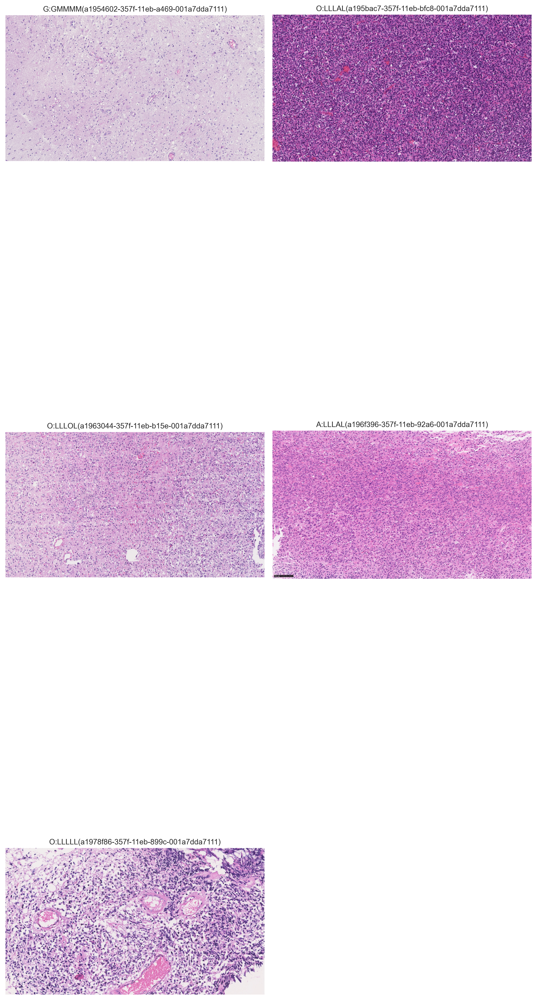

In [21]:
def display_images(images, titles=None, ncols=4, figsize=[10, -1], title_fontsize=10):
    n_images = len(images)
    nrows = int(np.ceil(n_images / ncols))  # 必要な行数を計算

    if titles is not None and len(titles) != n_images:
        raise ValueError('Invalid title count', titles)
    print('col', ncols, 'row', nrows)
    if figsize[1] < 0:
        figsize[1] = int(figsize[0]/(images[0].width*ncols)*(images[0].height*(nrows**2)))
    print(figsize)
    fig = plt.figure(figsize=figsize)

    # 画像とタイトルを配置
    for idx, img in enumerate(images):
        ax = fig.add_subplot(nrows, ncols, idx + 1)
        ax.imshow(img, aspect='equal')
        if titles is not None:
            ax.set_title(titles[idx], fontsize=title_fontsize, pad=5)
        ax.axis('off')  # 軸を非表示
    
    # サブプロット間の余白を調整
    plt.tight_layout()
    # return fig

display_images(
    eb2i(eb_only_f),
    eb_only_f['title'].values,
    ncols=2,
)

col 2 row 9
[10, 11]


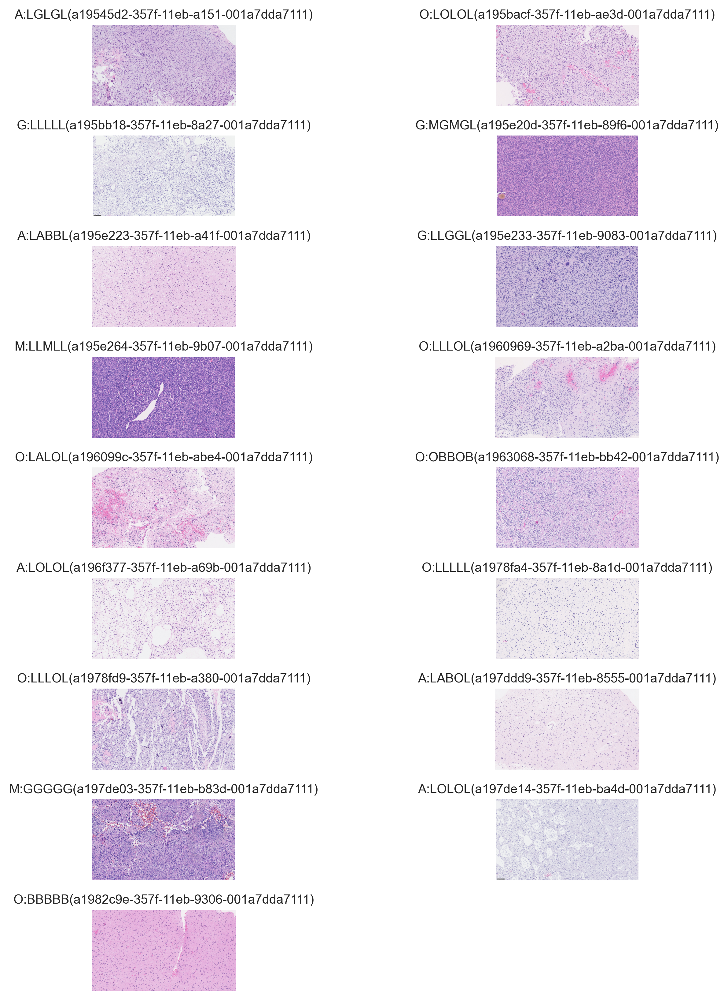

In [14]:
display_images(
    eb2i(eb_only_u),
    eb_only_u['title'].values,
    ncols=2,
)

In [12]:
f_uni = inspect('frozen_uni_500', target='cv')
u_uni = inspect('unfrozen_uni_500', target='cv')
f_set = set(f_uni['name'].unique())
u_set = set(u_uni['name'].unique())
common_set = f_set & u_set

cv_common = f_uni[f_uni['name'].isin(common_set)]
cv_only_f = f_uni[f_uni['name'].isin(f_set - common_set)]
cv_only_u = u_uni[u_uni['name'].isin(u_set - common_set)]

print('Common', len(common_set))
display(cv_common)
print('Only frozen', len(f_set))
display(cv_only_f)
print('Only unfrozen', len(u_set))
display(cv_only_u)

Common 3


,name,label,gt,pred(vote),pred(sum),correct,acc,correct3,correct4,L,M,G,A,O,B,fold,pred,title
51,N22-263,L,L,G,G,0,0.099502,0,0,0.112532,0.012034,0.346296,0.246341,0.235683,4.711311e-02,3,G,L:G(N22-263)
39,N21-327,G,G,L,L,0,0.395062,0,0,0.566541,0.001254,0.387284,0.038426,0.006495,4.342557e-07,4,L,G:L(N21-327)
69,N20-216,M,M,G,G,0,0.191934,0,0,0.058514,0.225659,0.709200,0.005181,0.001433,1.311676e-05,4,G,M:G(N20-216)


Only frozen 4


,name,label,gt,pred(vote),pred(sum),correct,acc,correct3,correct4,L,M,G,A,O,B,fold,pred,title
41,22-0107,G,G,M,M,0,0.077213,0,0,0.293542,0.601153,0.103147,0.00087,0.001271,0.000018,1,M,G:M(22-0107)


Only unfrozen 4


,name,label,gt,pred(vote),pred(sum),correct,acc,correct3,correct4,L,M,G,A,O,B,fold,pred,title
66,21-2158,M,M,L,L,0,0.423529,0,0,0.544,0.421595,0.031743,0.00236,0.000213,0.00009,1,L,M:L(21-2158)


col 4 row 1
[10, 11]


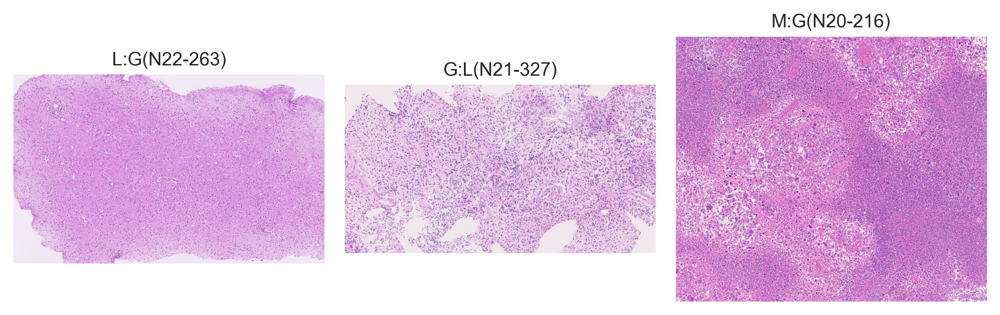

In [7]:
display_images(
    [Image.open(f'data/images/enda4/{r["label"]}/{r["name"]}_01.jpg') for i, r in cv_common.iterrows()],
    cv_common['title'].values
)

col 4 row 1
[10, 11]


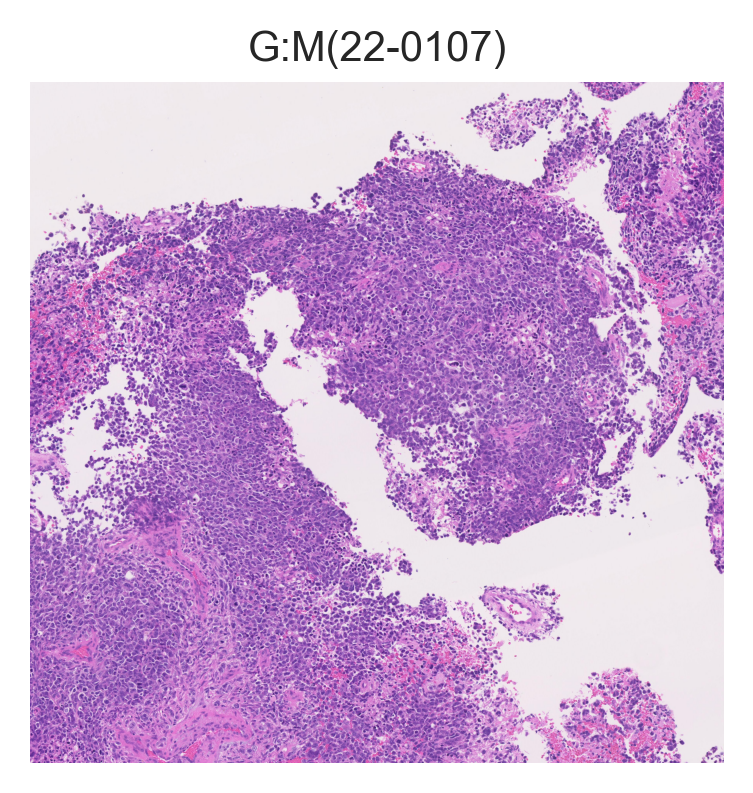

In [8]:
display_images(
    [Image.open(f'data/images/enda4/{r["label"]}/{r["name"]}_01.jpg') for i, r in cv_only_f.iterrows()],
    cv_only_f['title'].values
)

col 4 row 1
[10, 11]


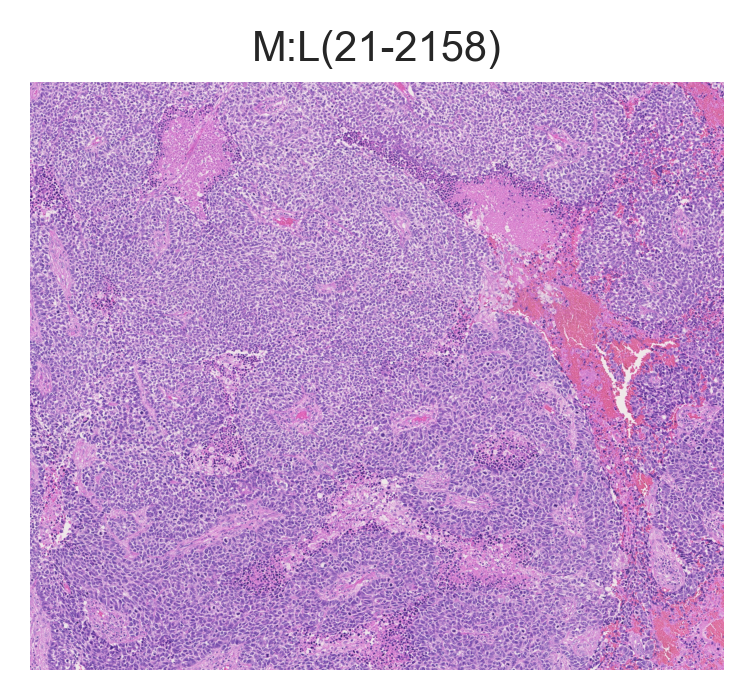

In [9]:
display_images(
    [Image.open(f'data/images/enda4/{r["label"]}/{r["name"]}_01.jpg') for i, r in cv_only_u.iterrows()],
    cv_only_u['title'].values
)